# **Analysis of Cellular Network Coverage in Diverse Terrains of Sri Lanka** 📡

This project aims to use Geographic Information Systems (GIS) to analyze how different terrains impact the cellular network coverage in Sri Lanka. The main goal is to assess how geographic and demographic features influence signal propagation and distribution by integrating cellular tower data with elevation models. This analysis will help identify coverage gaps and propose optimal locations for new cellular towers based on population density and signal propagation, thereby improving network service across different regions of the country.

In [ ]:
!pip install ipywidgets rasterio geopandas numpy pandas matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 61.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 56.9 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!cp -r /content/drive/MyDrive/GIS_Datasets/* /content/

Mounted at /content/drive


Upload relevent dataset files

In [ ]:
# from google.colab import files

# uploaded = files.upload()

# print("Uploaded files:")
# for file_name in uploaded.keys():
#     print(file_name)

In [ ]:
import geopandas as gpd
import rasterio


towers_data = gpd.read_file("towers preprocessed.csv")
print("Tower Details:")
print(towers_data.head())

gadm_level_0 = gpd.read_file("gadm41_LKA_0.shp")
print("\nLevel 0 Boundary (National):")
print(gadm_level_0.head())

gadm_level_1 = gpd.read_file("gadm41_LKA_1.shp")
print("\nLevel 1 Boundary (District):")
print(gadm_level_1.head())

population_data = gpd.read_file("lka_pd_2020_1km_ASCII_XYZ.csv")
print("\nPopulation Data:")
print(population_data.head())

with rasterio.open("Signal Propagation_1km_res_clipped.tif") as src:
    print("\nSignal Propagation Raster Dataset Information:\n")
    for key, value in src.profile.items():
        print(f"{key}: {value}")

Tower Details:
  firstseendate lastseendate  Carrier Technology height     latitude  \
0       1.71E12      1.71E12  Mobitel       UMTS     70  6.111107728   
1       1.71E12      1.71E12  Mobitel       UMTS     70  6.115207856   
2       1.71E12      1.71E12  Mobitel       UMTS     70  6.131207664   
3       1.72E12      1.72E12  Mobitel       UMTS     70  6.133108283   
4       1.71E12      1.73E12  Mobitel       UMTS     70   6.13330803   

     longitude  
0  80.18751921  
1  80.19341871  
2  80.18811875  
3   80.1710186  
4   80.1786188  

Level 0 Boundary (National):
   id GID_0    COUNTRY                                           geometry
0   1   LKA  Sri Lanka  MULTIPOLYGON (((217591.036 97734.875, 217375.6...

Level 1 Boundary (District):
     GID_1 GID_0    COUNTRY        NAME_1 VARNAME_1 NL_NAME_1       TYPE_1  \
0  LKA.1_1   LKA  Sri Lanka        Ampara   Amparai        NA  Distrikkaya   
1  LKA.2_1   LKA  Sri Lanka  Anuradhapura        NA        NA  Distrikkaya   
2  LKA.3

In [ ]:
import pandas as pd
import folium
from google.colab import files
from IPython.display import display
import geopandas as gpd
from ipywidgets import interact


data = pd.read_csv('towers preprocessed.csv', delimiter=';')

#Create the map centered on the average latitude and longitude
map_center = [data['latitude'].mean(), data['longitude'].mean()]
tower_map = folium.Map(location=map_center, zoom_start=8)

#Add markers for each tower
for _, row in data.iterrows():
    tower_info = f"Carrier: {row['Carrier']}<br>Technology: {row['Technology']}<br>Height: {row['height']} m"
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(tower_info, max_width=300),
        icon=folium.Icon(color='blue', icon='info-sign')
    ).add_to(tower_map)

#Display the map directly in the notebook
display(tower_map)


Towers Classify by District/Province


In [ ]:
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster
from ipywidgets import widgets, interact
import os
from google.colab import files

# Step 1: Load the Towers Dataset
df = pd.read_csv('towers preprocessed.csv', sep=';')

# Convert the DataFrame to a GeoDataFrame
towers = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df['longitude'], df['latitude'])
)


towers.set_crs("EPSG:4326", inplace=True)




# Step 3: Load the district boundaries as a GeoDataFrame
districts = gpd.read_file('gadm41_LKA_1.shp')


districts_projected = districts.to_crs("EPSG:4326")

district_dropdown = widgets.Dropdown(
    options=districts['NAME_1'].unique().tolist(),  # Unique district names
    description='District:',
    disabled=False
)


# Calculate the centroid in the projected CRS


# Step 4: Function to display the map
def display_map(district_name):
    # Filter for the selected district
    selected_district = districts[districts['NAME_1'] == district_name]

    # Reproject the selected district to a projected CRS for accurate centroid calculation
    selected_district_projected = selected_district.to_crs("EPSG:5234")
    district_center_projected = selected_district_projected.geometry.centroid.iloc[0]

    # Convert the centroid back to EPSG:4326 for Folium
    district_center_geographic = gpd.GeoSeries([district_center_projected], crs="EPSG:5234").to_crs("EPSG:4326").iloc[0]
    center_coords = (district_center_geographic.y, district_center_geographic.x)

    # Perform the spatial join
    towers_in_district = gpd.sjoin(towers, selected_district, predicate='within')

    # Create a Folium map centered around the district
    m = folium.Map(location=center_coords, zoom_start=10)

    # Add district boundary to the map
    folium.GeoJson(
        selected_district,
        name='District Boundary',
        style_function=lambda x: {
            'fillColor': 'blue',
            'color': 'black',
            'weight': 2,
            'fillOpacity': 0.2
        }
    ).add_to(m)

    # Add towers to the map
    marker_cluster = MarkerCluster().add_to(m)
    for _, tower in towers_in_district.iterrows():
        folium.Marker(
            location=[tower.geometry.y, tower.geometry.x],
            popup=(f"<b>Carrier:</b> {tower['Carrier']}<br>"
                   f"<b>Technology:</b> {tower['Technology']}<br>"
                   f"<b>Height:</b> {tower['height']}m")
        ).add_to(marker_cluster)

    return m

# Step 6: Use interact to update the map
interact(lambda district_name: display_map(district_name), district_name=district_dropdown)

Classify by Technology Objective: Filter and display cellular towers based on their technology (e.g., 4G, UMTS, LTE).

In [ ]:
from google.colab import files
import pandas as pd
import folium
from ipywidgets import widgets, interact
import matplotlib.pyplot as plt


df = pd.read_csv('towers preprocessed.csv', sep=';')

available_technologies = df['Technology'].dropna().unique()
available_technologies.sort()

# Dropdown widget
technology_dropdown = widgets.Dropdown(
    options=available_technologies,
    description='Technology:',
    value=available_technologies[0],
    style={'description_width': 'initial'}
)

# Marker color map based on technology type
color_map = {
    '4G': 'purple',
    'UMTS': 'red',
    'LTE': 'blue',
    'GSM': 'green',
}

def display_towers_by_technology(technology):
    filtered_df = df[df['Technology'] == technology]

    if filtered_df.empty:
        print(f"No towers found for technology: {technology}")
        return

    sri_lanka_map = folium.Map(location=[7.8731, 80.7718], zoom_start=8)

    # Add markers for the filtered towers
    for _, row in filtered_df.iterrows():
        folium.Marker(
            location=[row['latitude'], row['longitude']],
            popup=folium.Popup(
                f"<b>Carrier:</b> {row['Carrier']}<br>"
                f"<b>Technology:</b> {row['Technology']}<br>"
                f"<b>Location:</b> ({row['latitude']}, {row['longitude']})",
                max_width=250
            ),
            icon=folium.Icon(color=color_map.get(row['Technology'], 'gray'), icon="info-sign")
        ).add_to(sri_lanka_map)

    display(sri_lanka_map)

interact(display_towers_by_technology, technology=technology_dropdown)





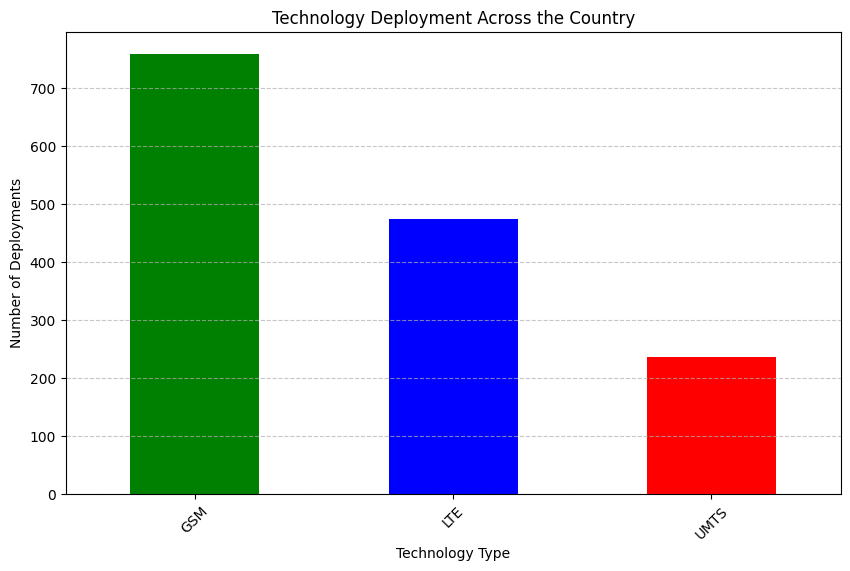

In [ ]:
def plot_technology_deployment():
    tech_counts = df['Technology'].value_counts()

    plt.figure(figsize=(10, 6))
    tech_counts.plot(kind='bar', color=['green', 'blue', 'red', 'purple'])
    plt.title('Technology Deployment Across the Country')
    plt.xlabel('Technology Type')
    plt.ylabel('Number of Deployments')
    plt.xticks(rotation=45)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

plot_technology_deployment()

**Classify by Carrier**

This section focuses on analyzing cellular towers based on their carrier (e.g., Mobitel, Dialog, Airtel, Hutch).

Displayed a pie chart which represents the percentage distribution of towers for each carrier, providing insights into carrier presence and coverage.


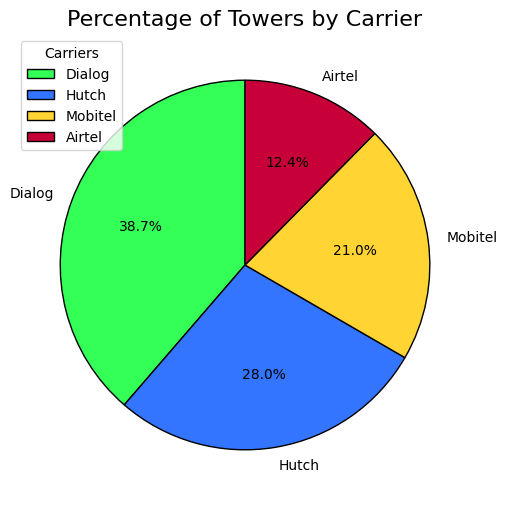

In [ ]:
from google.colab import files
import pandas as pd
import matplotlib.pyplot as plt
import folium
from ipywidgets import widgets, interact

# Load the cellular tower dataset
df = pd.read_csv('towers preprocessed.csv', sep=';')

# Remove unnecessary spaces or quotes from column names
df.columns = df.columns.str.strip().str.replace('"', '')

# Count the number of towers for each carrier
carrier_counts = df['Carrier'].value_counts()

# Plot a pie chart
plt.figure(figsize=(8, 6))

# Define set of colors to be used for each carrier in the pie chart
colors = ['#33FF57', '#3375FF', '#FFD433', '#C70039', '#3375FF']

# Generate pie chart with customized settings
carrier_counts.plot.pie(
    autopct='%1.1f%%',
    startangle=90,
    colors=colors,
    wedgeprops={'edgecolor': 'black'}
)
plt.title('Percentage of Towers by Carrier', fontsize=16)
plt.ylabel('')
plt.legend(title='Carriers', loc='best')
plt.show()


A dropdown menu allows to filter and highlight towers belonging to a selected carrier and display only the towers belonging to the selected carrier. Used carrier-specific colors to enhance the visualization for better clarity.

In [ ]:
# Define a color dictionary for carriers for the map
carrier_colors = {
    'Mobitel': 'orange',
    'Dialog': 'green',
    'Airtel': 'red',
    'Hutch': 'blue',
    'Other': 'gray'
}

# Filter unique carriers
unique_carriers = df['Carrier'].dropna().unique()

# Define the map display function
def carrier_map(carrier):
    # Filter the dataset to get only the towers belonging to the selected carrie
    filtered_data = df[df['Carrier'] == carrier]

    if not filtered_data.empty:
        # center the map on the average latitude and longitude of the towers
        center_lat = filtered_data['latitude'].mean()
        center_lon = filtered_data['longitude'].mean()
    else:
        # center the map on the average coordinates of all towers
        center_lat, center_lon = df['latitude'].mean(), df['longitude'].mean()

    # Initialize the map with calculated latitude and longitude
    map_carrier = folium.Map(location=[center_lat, center_lon], zoom_start=8)

    # Retrieve the carrier specific color
    marker_color = carrier_colors.get(carrier, 'gray')

    # Get Each tower for the selected carrier and add a marker
    for _, row in filtered_data.iterrows():

      # Add detailed information about each tower
        tooltip = (
            f"Carrier: {row['Carrier']}<br>"
            f"Technology: {row['Technology']}<br>"
            f"Height: {row['height']}m<br>"
            f"First Seen: {row['firstseendate']}<br>"
            f"Last Seen: {row['lastseendate']}"
        )

        # Add a marker on the map with the specified location, popup information, and color
        folium.Marker(
            location=[row['latitude'], row['longitude']],
            popup=tooltip,
            icon=folium.Icon(color=marker_color, icon="info-sign"),
        ).add_to(map_carrier)

    return map_carrier

# Dropdown for carrier selection
carrier_dropdown = widgets.Dropdown(
    options=unique_carriers,
    description="Carrier:",
    style={"description_width": "initial"},
)

# Interaction to update the map according to the selected carrier
interact(carrier_map, carrier=carrier_dropdown)


A timelapse of the cell towers created in different locations of Sri Lanka over time. (from 23/02/2012 to 27/10/2024 )

Displayed in an animation with interactive playing options.

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from datetime import datetime
from IPython.display import HTML, Video

# Load the tower dataset
df = pd.read_csv("towers preprocessed.csv", delimiter=';')

# Convert 'firstseendate' to datetime
df['firstseendate'] = df['firstseendate'] = pd.to_datetime(df['firstseendate'] / 1000, unit='s')

# Load Sri Lanka boundary for the map
boundary = gpd.read_file('gadm41_LKA_1.shp')
# Get unique dates sorted
unique_dates = df['firstseendate'].sort_values().unique()

# Initialize the plot
fig, ax = plt.subplots(figsize=(10, 8))
boundary.plot(ax=ax, color='white', edgecolor='black')  # Plot Sri Lanka boundary

# Function to update each frame
def update(frame):
    ax.clear()
    boundary.plot(ax=ax, color='white', edgecolor='black', zorder=1)  # Redraw the boundary
    towers_to_date = df[df['firstseendate'] <= frame]  # Filter towers up to the frame's date
    ax.scatter(
        towers_to_date['longitude'],
        towers_to_date['latitude'],
        color='red', alpha=0.7, s=10, label='Tower', zorder=2
    )
    ax.set_title(f"Towers active up to: {frame.strftime('%Y-%m-%d')}", fontsize=14)
    ax.legend(loc='upper right')

# Create the animation
ani = FuncAnimation(fig, update, frames=unique_dates, repeat=False)

plt.close(fig)

# Save as HTML and display directly
html_animation = ani.to_jshtml()
HTML(html_animation)



Population Analysis

In [ ]:
import pandas as pd
import geopandas as gpd
import folium
import plotly.express as px
from folium.plugins import HeatMap
from google.colab import files
from IPython.display import display


#  Load the shapefile data into a GeoDataFrame for further processing.
districts = gpd.read_file('gadm41_LKA_1.shp')

# Load the population data from the uploaded CSV file and rename columns for consistency.
pop_data = pd.read_csv('lka_pd_2020_1km_ASCII_XYZ.csv')

# Rename columns for consistency
pop_data.columns = ['longitude', 'latitude', 'population']


# Create GeoDataFrame for population points
#Convert population data into a GeoDataFrame to facilitate spatial analysis.
pop_points = gpd.GeoDataFrame(pop_data, geometry=gpd.points_from_xy(pop_data.longitude, pop_data.latitude))
pop_points.crs = districts.crs  # Ensure CRS matches

# Aggregate population data by district using a spatial join
#  Perform a spatial join to associate population points with districts and calculate total population per district.
district_population = gpd.sjoin(districts, pop_points, how="left", predicate="contains").groupby('NAME_1')['population'].sum()

# Add the aggregated population data back to the districts GeoDataFrame
districts['population'] = districts['NAME_1'].map(district_population)

# Sort the data by population for better visualization
districts_sorted = districts[['NAME_1', 'population']].sort_values('population', ascending=False)

# Create a bar chart using Plotly
fig = px.bar(districts_sorted,
             x='NAME_1',
             y='population',
             title='Population by District',
             labels={'NAME_1': 'District', 'population': 'Population'},
             hover_data={'NAME_1': True, 'population': True})

# Customize layout for better readability
fig.update_layout(
    xaxis_tickangle=-45,  # Rotate x-axis labels for better readability
    xaxis_title='District',
    yaxis_title='Population',
    template='plotly_dark',
    autosize=True
)

# Show the interactive plot with hover features
fig.show()

Population Heatmap of Srilanka

In [ ]:
#  Create a base map
#  Initialize a base map centered on the mean latitude and longitude of the population data.
map_center = [pop_data['latitude'].mean(), pop_data['longitude'].mean()]
population_map = folium.Map(location=map_center, zoom_start=7)


# Visualize population density using a heatmap overlay on the map.
heat_data = pop_data[['latitude', 'longitude', 'population']].values.tolist()
HeatMap(heat_data, radius=10, name="Population Density").add_to(population_map)

# Ensure the map displays correctly after adding layers
display(population_map)


Population With District Boundaries

In [ ]:
#  Add district boundaries with hover tooltips
# Overlay district boundaries on the map with interactive tooltips showing district name and population.
geojson = folium.GeoJson(
    data=districts,
    name="District Boundaries",
    tooltip=folium.features.GeoJsonTooltip(
        fields=["NAME_1", "population"],  # Fields to display in the tooltip
        aliases=["District: ", "Population: "],  # Aliases for the field names
        localize=True
    ),
    style_function=lambda x: {
        "fillColor": "#ffaf00",
        "color": "black",
        "weight": 2,
        "fillOpacity": 0.7,
    },
)
geojson.add_to(population_map)

# Ensure the map displays correctly after adding layers
display(population_map)


**Signal Propagation due to Terrain Analysis**

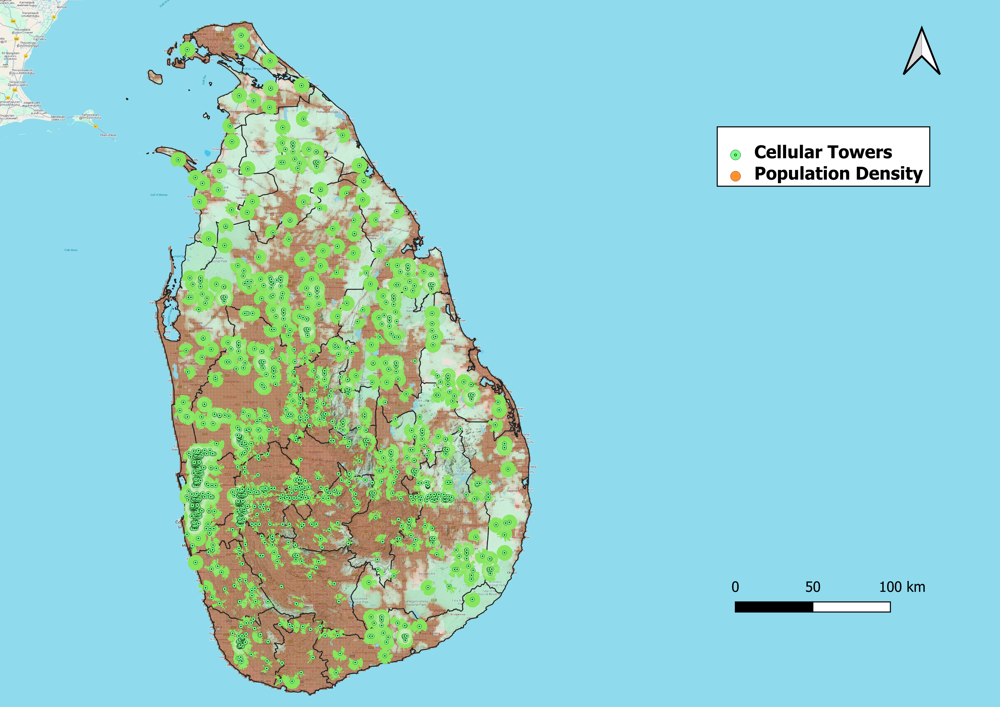

Rasterize the population Density Vector FIle

In [ ]:
import pandas as pd
import numpy as np
import rasterio
from rasterio.features import rasterize
from rasterio.transform import from_origin
from shapely.geometry import Point

# Load Population Density CSV
population_df = pd.read_csv('lka_pd_2020_1km_ASCII_XYZ.csv')


# Extract X, Y, and Z columns
x_coords = population_df['X'].values
y_coords = population_df['Y'].values
z_values = population_df['Z'].values

# Define raster properties
min_x, min_y = x_coords.min(), y_coords.min()
max_x, max_y = x_coords.max(), y_coords.max()

# Resolution (adjust as per requirement)
pixel_size = 0.01
width = int((max_x - min_x) / pixel_size)
height = int((max_y - min_y) / pixel_size)

# Create a raster transformation
transform = from_origin(min_x, max_y, pixel_size, pixel_size)

# Convert coordinates into Shapely Point geometries
geometries = [Point(x, y) for x, y in zip(x_coords, y_coords)]

# Rasterize Population Density (convert geometries into raster)
population_raster = rasterize(
    [(geom, value) for geom, value in zip(geometries, z_values)],
    out_shape=(height, width),
    transform=transform,
    fill=0,  # No data value
    dtype='float32'
)

# Save Population Density Raster
output_filename = 'population_density.tif'
with rasterio.open(
    output_filename, 'w',
    driver='GTiff',
    height=population_raster.shape[0],
    width=population_raster.shape[1],
    count=1,
    dtype=population_raster.dtype,
    crs='EPSG:4326',
    transform=transform
) as dst:
    dst.write(population_raster, 1)

print(f"Population raster saved as {output_filename}")


Population raster saved as population_density.tif


Resample Population Raster match to Signal Propagation's raster resolution and extent

In [ ]:
import rasterio
from rasterio.warp import reproject, Resampling
import numpy as np

# Open the population raster and signal raster
with rasterio.open('population_density.tif') as src_population:
    with rasterio.open('Signal Propagation_1km_res_clipped.tif') as src_signal:

        # Check if the extents and resolutions match
        if src_population.width != src_signal.width or src_population.height != src_signal.height:
            print("Resampling required!")

            # Define the transform and target resolution from signal raster
            transform = src_signal.transform
            target_resolution = (src_signal.width, src_signal.height)

            # Create an array to hold the resampled population data
            resampled_population = np.empty((src_signal.height, src_signal.width), dtype='float32')

            # Reproject the population raster to match the signal raster's resolution and extent
            reproject(
                source=rasterio.band(src_population, 1),
                destination=resampled_population,
                src_transform=src_population.transform,
                src_crs=src_population.crs,
                dst_transform=transform,
                dst_crs=src_signal.crs,
                resampling=Resampling.nearest
            )


            print(f"Population raster resampled to: {resampled_population.shape}")

            # Save the resampled population raster
            with rasterio.open(
                'resampled_population.tif', 'w',
                driver='GTiff',
                height=resampled_population.shape[0],
                width=resampled_population.shape[1],
                count=1,
                dtype=resampled_population.dtype,
                crs=src_signal.crs,
                transform=transform
            ) as dst:
                dst.write(resampled_population, 1)

            print("Resampled population raster saved.")


Resampling required!
Population raster resampled to: (432, 258)
Resampled population raster saved.


Analyse Places where having population with no signal coverage

In [ ]:
import matplotlib.patches as mpatches

# Open the population raster and signal raster
with rasterio.open('resampled_population.tif') as src_population:
    population_data = src_population.read(1)

with rasterio.open('Signal Propagation_1km_res_clipped.tif') as src_signal:
    signal_data = src_signal.read(1)


# Subtract signal coverage from population density
# Set signal coverage  to 0 & have population
result_data = np.where(signal_data == 0, population_data, 0)


# Save the result raster (population with no signal coverage)
with rasterio.open(
    'population_no_signal_coverage.tif', 'w',
    driver='GTiff',
    height=result_data.shape[0],
    width=result_data.shape[1],
    count=1,
    dtype=result_data.dtype,
    crs=src_population.crs,
    transform=src_population.transform
) as dst:
    dst.write(result_data, 1)

print("Resulting raster (population with no signal coverage) saved as 'population_no_signal_coverage.tif'.")


Resulting raster (population with no signal coverage) saved as 'population_no_signal_coverage.tif'.


Clip the population with no signal coverage raster file with Srilanka Boundry Shape File.

In [ ]:
import geopandas as gpd
from rasterio.mask import mask
import rasterio
import numpy as np

# Load the boundary shapefile
boundary = gpd.read_file('gadm41_LKA_0.shp')

# Apply the mask
with rasterio.open('population_no_signal_coverage.tif') as src_result:
    # Convert boundary to the same CRS as the raster
    boundary = boundary.to_crs(src_result.crs)

    # Apply the mask (crop=False keeps the original extent but masks outside areas as no data)
    out_image, out_transform = mask(src_result, boundary.geometry, crop=False, nodata=np.nan)
    out_meta = src_result.meta.copy()

# Squeeze the out_image to remove the extra dimension
out_image = np.squeeze(out_image)

# Update metadata for the clipped raster
out_meta.update({
    "height": out_image.shape[0],
    "width": out_image.shape[1],
    "transform": out_transform,
    "nodata": np.nan
})

# Save the masked raster
with rasterio.open('population_no_signal_within_boundary.tif', 'w', **out_meta) as dest:
    dest.write(out_image, 1)

print("Clipped raster saved as 'population_no_signal_within_boundary.tif'.")


Clipped raster saved as 'population_no_signal_within_boundary.tif'.


Visualize the Final Result Raster

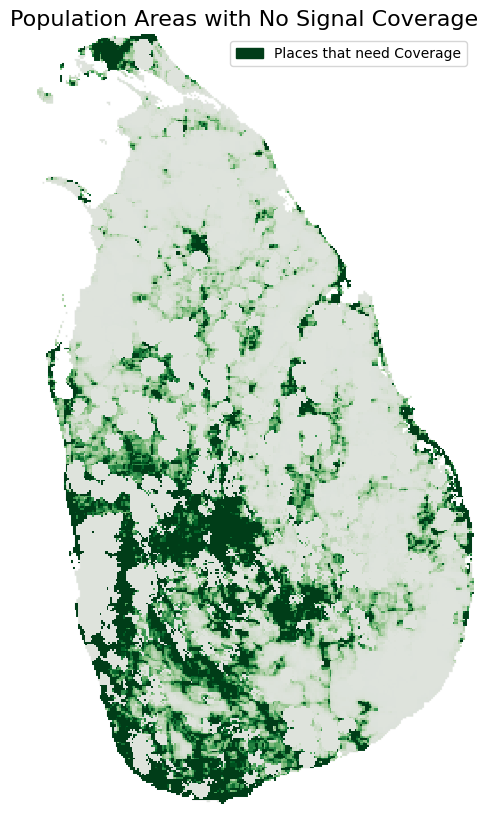

In [ ]:


# Load the clipped raster
with rasterio.open('population_no_signal_within_boundary.tif') as clipped_raster:
    clipped_data = clipped_raster.read(1)

# Create a mask for no-data areas
no_data_mask = np.isnan(clipped_data)

# Visualize
plt.figure(figsize=(10, 10))
plt.title("Population Areas with No Signal Coverage", fontsize=16)
plt.imshow(clipped_data, cmap='Greens', interpolation='nearest')
plt.axis('off')


plt.clim(vmin=0, vmax=np.percentile(result_data,92))

# Hides the axes
plt.axis('off')

legend_labels = ['Places that need Coverage']
patches = [
    mpatches.Patch(color='#013d19', label=legend_labels[0]),

]
plt.legend(handles=patches, loc='upper right')
plt.imshow(no_data_mask, cmap='gray', alpha=0.1)

# Display the plot
plt.show()